<h1> DATA PROCESSING AND VISUALISATION </h1>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
dataframes = {}
time_stamps = [0, 20, 40, 60, 80, 100, 120, 140, 160]

for time in time_stamps:
    path = f"ZIF_MOF_V1_T{time}.xlsx"
    dataframes[time] = pd.read_excel(path, skiprows=10)

In [9]:
from scipy.ndimage import gaussian_filter1d

<h2>Absorbance spectrum of the different samples</h2>

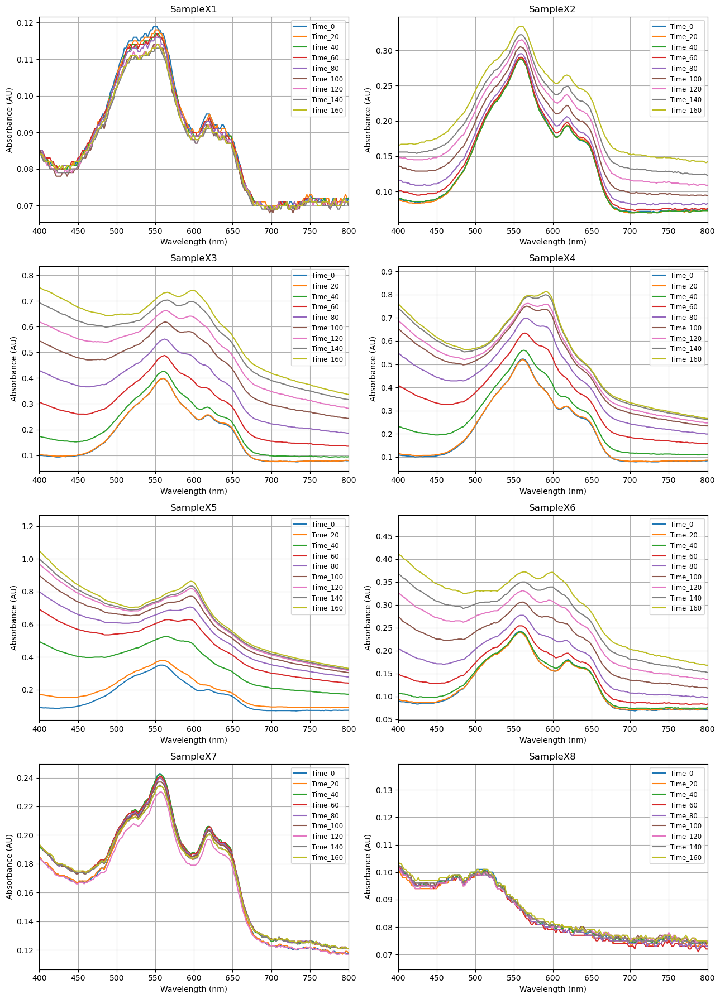

In [7]:
fig, axes = plt.subplots(4, 2, figsize=(13, 18))  
axes = axes.flatten()  
for i in range(8):
    ax = axes[i]
    for j in range(9):
        wavelengths = dataframes[j*20].iloc[0, 25:].values
        absorbance = dataframes[j*20].iloc[i+1, 25:].values
        # absorbance = gaussian_filter1d(absorbance, sigma=1)
        ax.plot(wavelengths, absorbance, label=f'Time_{j*20}')
    ax.set_title(f"SampleX{i+1}")
    ax.set_xlabel("Wavelength (nm)")
    ax.set_ylabel("Absorbance (AU)")
    ax.set_xlim(400, 800)
    ax.grid(True)
    ax.legend(fontsize='small', loc='upper right')

plt.tight_layout()
plt.show()

<h2>Time vs Normalised Absorbance</h2>

<h3>For 450nm</h3>

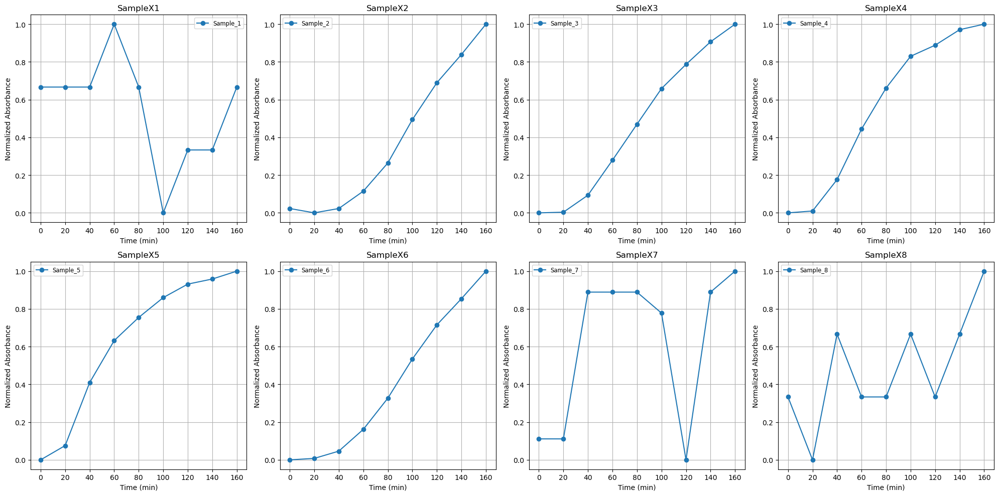

In [10]:
fig, axes = plt.subplots(2, 4, figsize=(20, 10))  
axes = axes.flatten()  
for i in range(8):
    ax = axes[i]
    I_t_450= []
    for j in range(9):
        df = dataframes[j*20]
        if df.shape[0] <= i + 1:
            continue  # skip if row is missing
        row_series = df.iloc[0]
        matching_column = row_series[row_series == 450].index[0]
        absorbance_at_450 = df.loc[i+1, matching_column]
        I_t_450.append(absorbance_at_450)

    I_t_450 = np.array(I_t_450)
    A_t_450 = (I_t_450 - np.min(I_t_450)) / (np.max(I_t_450) - np.min(I_t_450))

    ax.plot(range(0, 180, 20), A_t_450, label=f'Sample_{i+1}', marker='o')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Normalized Absorbance")
    ax.set_title(f"SampleX{i+1}")
    ax.grid(True)
    ax.legend(fontsize='small')

plt.tight_layout()
plt.show()

<h3>For 400nm</h3>

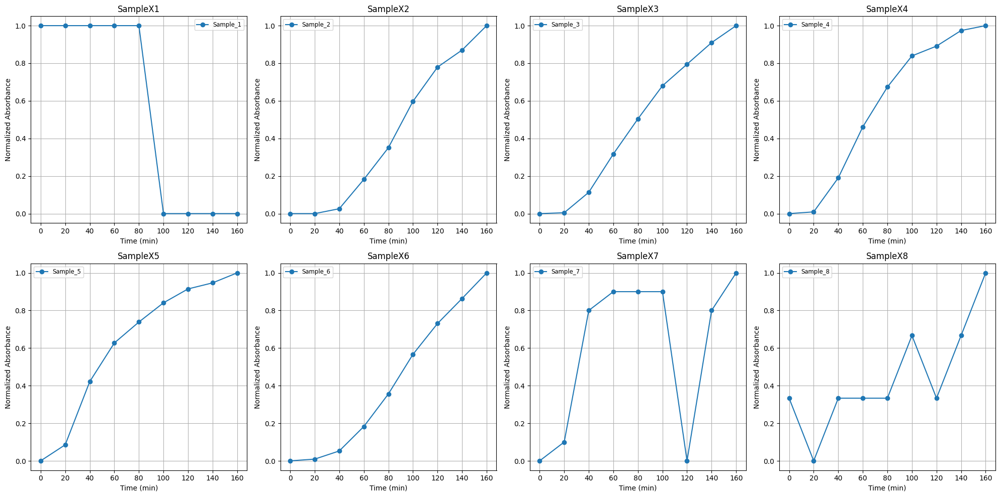

In [23]:
fig, axes = plt.subplots(2, 4, figsize=(20, 10))  
axes = axes.flatten()  
for i in range(8):
    ax = axes[i]
    I_t_400 = []
    for j in range(9):
        df = dataframes[j*20]
        if df.shape[0] <= i + 1:
            continue  # skip if row is missing
        row_series = df.iloc[0]
        matching_column = row_series[row_series == 400].index[0]
        absorbance_at_400 = df.loc[i+1, matching_column]
        I_t_400.append(absorbance_at_400)

    I_t_400 = np.array(I_t_400)
    A_t_400 = (I_t_400 - np.min(I_t_400)) / (np.max(I_t_400) - np.min(I_t_400))

    ax.plot(range(0, 180, 20), A_t_400, label=f'Sample_{i+1}', marker='o')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Normalized Absorbance")
    ax.set_title(f"SampleX{i+1}")
    ax.grid(True)
    ax.legend(fontsize='small')

plt.tight_layout()
plt.show()

<h2>Gualtieri Model Fitting</h2> 

In [11]:
from scipy.optimize import curve_fit

In [12]:
from scipy.special import expit

def gualtieri_model(t, Kg, a, b):
    growth = 1 - np.exp(-np.power(Kg * t, 3))
    nucleation = expit((t - a) / b)  # stable sigmoid
    return growth * nucleation


<h3>For 450nm</h3>

<h4>With parameters K_g, a and b</h4>

This code implements a grid search optimization to find the best-fitting parameters for the Gualtieri crystallization model. The algorithm explores a three-dimensional parameter space by testing 100 different values of the growth rate constant (Kg) ranging from 0.01 to 0.1, combined with 5 values each for the nucleation parameters (a and b) ranging from 1 to 5, resulting in 2,500 total parameter combinations. For each combination, the code uses scipy's `curve_fit` function to fit the Gualtieri model to the experimental time-series data. The optimization tracks the parameter set that minimizes the L2 norm error between the fitted curve and experimental data, while ensuring all parameters remain physically meaningful (positive values). The algorithm evaluates fit quality based on an error threshold of 0.1.

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\424011021.py:34: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\424011021.py:17: RuntimeWarning: overflow encountered in exp
  growth = 1 - np.exp(-(kg * t)**3)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\424011021.py:18: RuntimeWarning: overflow encountered in exp
  nucleation = 1 / (1 + np.exp(-(t - a) / b))
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\424011021.py:19: RuntimeWarning: invalid value encountered in multiply
  return growth * nucleation


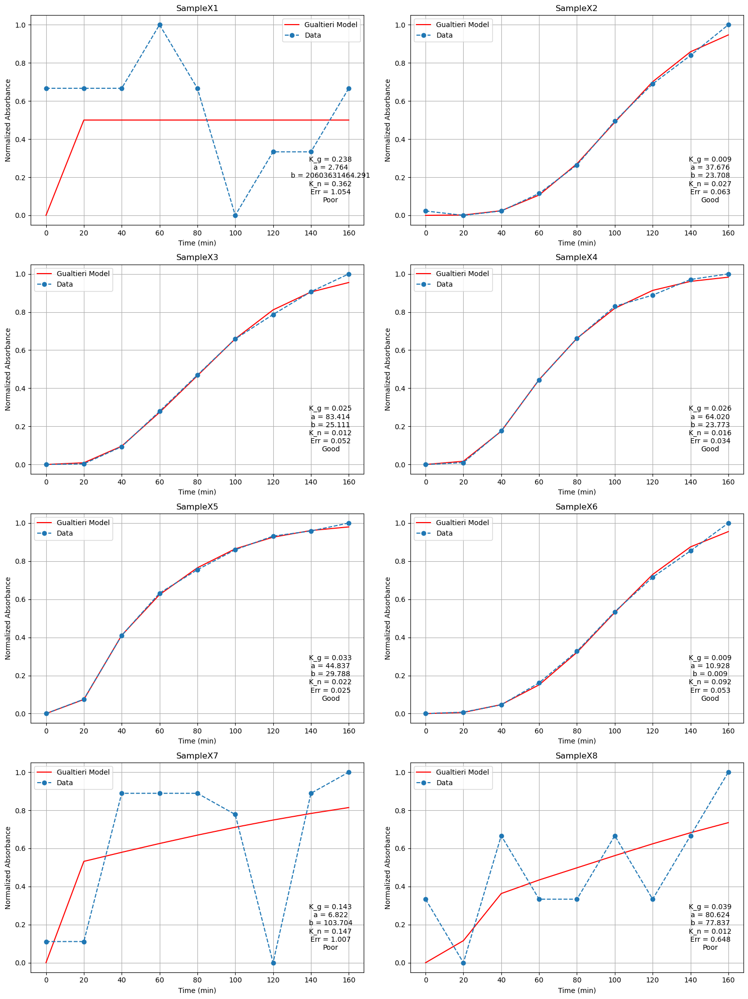

In [ ]:
fig, axs = plt.subplots(4, 2, figsize=(15, 20))  # Create a 2x2 grid of subplots
axs = axs.flatten()  # Flatten the 2D array of axes to 1D for easy indexing

for i in range(1, 9):
    I_t = []
    sample_number = i
    for j in range(9):
        row_series = dataframes[j*20].iloc[0]
        matching_columns = row_series[row_series == 450].index[0]
        absorbance_at_450 = dataframes[j*20].loc[sample_number, matching_columns]
        I_t.append(absorbance_at_450)
    
    alpha_data = (np.array(I_t) - min(I_t)) / (max(I_t) - min(I_t))
    t_data = np.array(range(0, 180, 20))

    def gualtieri_model(t, kg, a, b):
        growth = 1 - np.exp(-(kg * t)**3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)

    best_error = np.inf
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b)
                    error = np.linalg.norm(gualtieri_array - alpha_data)

                    if error < best_error and a > 0 and b > 0 and K_g > 0:
                        best_error = error
                        best_params = (K_g, a, b)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[i-1]  # Select the correct subplot
    if best_params is not None:
        K_g, a, b = best_params
        K_n = 1 / a
        error = np.linalg.norm(np.array(best_gualtieri_array) - alpha_data)

    fit_quality = "Good" if error < 0.1 else "Poor"

    ax.plot(t_data, best_gualtieri_array, label='Gualtieri Model', color='red')
    ax.plot(t_data, alpha_data, label='Data', marker='o', linestyle='--')
    ax.text(0.9, 0.1, f'K_g = {K_g:.4f}\na = {a:.4f}\nb = {b:.4f}\nK_n = {K_n:.4f}\nErr = {error:.4f}\n{fit_quality}',
            transform=ax.transAxes, fontsize=10, verticalalignment='bottom', horizontalalignment='center')

    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Normalized Absorbance")
    ax.set_title(f"SampleX{sample_number}")
    ax.grid(True)
    ax.legend()

plt.tight_layout()
plt.show()

<h4>With parameters K_g, a, b and I_max</h4>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\1766515879.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\1766515879.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\1766515879.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\1766515879.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\1766515879.py:37: OptimizeWarning: Covariance of the parameters could not b

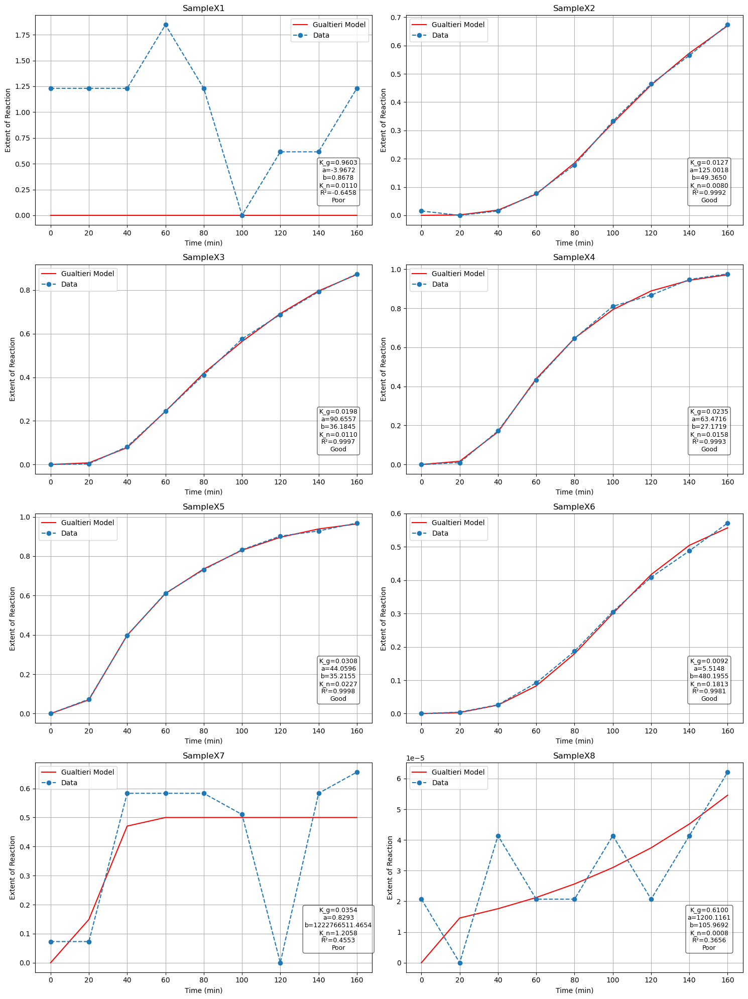

In [27]:
from sklearn.metrics import r2_score

fig, axs = plt.subplots(4, 2, figsize=(15, 20))  # 2x2 grid of subplots
axs = axs.flatten()  # Flatten to 1D list for easy indexing

for i in range(1, 9): 
    I_t = []
    sample_number = i
    for j in range(9):
        row_series = dataframes[j*20].iloc[0]
        matching_columns = row_series[row_series == 450].index[0]
        absorbance_at_450 = dataframes[j*20].loc[sample_number, matching_columns]
        I_t.append(absorbance_at_450)
    
    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, 180, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t)**3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g = popt[0]
                    a = popt[1]
                    b = popt[2]
                    I_max = popt[3]
                    
                    gualtieri_array = [gualtieri_model(t, K_g, a, b, I_max) for t in t_data]
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[i - 1]  # Select subplot

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)
    else:
        best_gualtieri_array = [0] * len(t_data)
        
    fit_quality = "Good" if r2 > 0.9 else "Poor"

    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red')
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o', linestyle='--')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number}")
    ax.grid(True)
    ax.legend()
    
    # Annotate fit parameters
    ax.text(0.9, 0.1, f'K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}',
            transform=ax.transAxes, fontsize=9,
            ha='center', va='bottom', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.6))

plt.tight_layout()
plt.show()


<h3>For 400nm</h3>

<h4>With parameters K_g, a and b</h4>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\719451135.py:34: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\719451135.py:18: RuntimeWarning: overflow encountered in exp
  nucleation = 1 / (1 + np.exp(-(t - a) / b))
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\719451135.py:17: RuntimeWarning: overflow encountered in exp
  growth = 1 - np.exp(-(kg * t)**3)
c:\Users\hardi\miniconda3\envs\axo\Lib\site-packages\scipy\optimize\_minpack_py.py:497: RuntimeWarning: overflow encountered in matmul
  cov_x = invR @ invR.T
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\719451135.py:19: RuntimeWarning: invalid value encountered in multiply
  return growth * nucleation


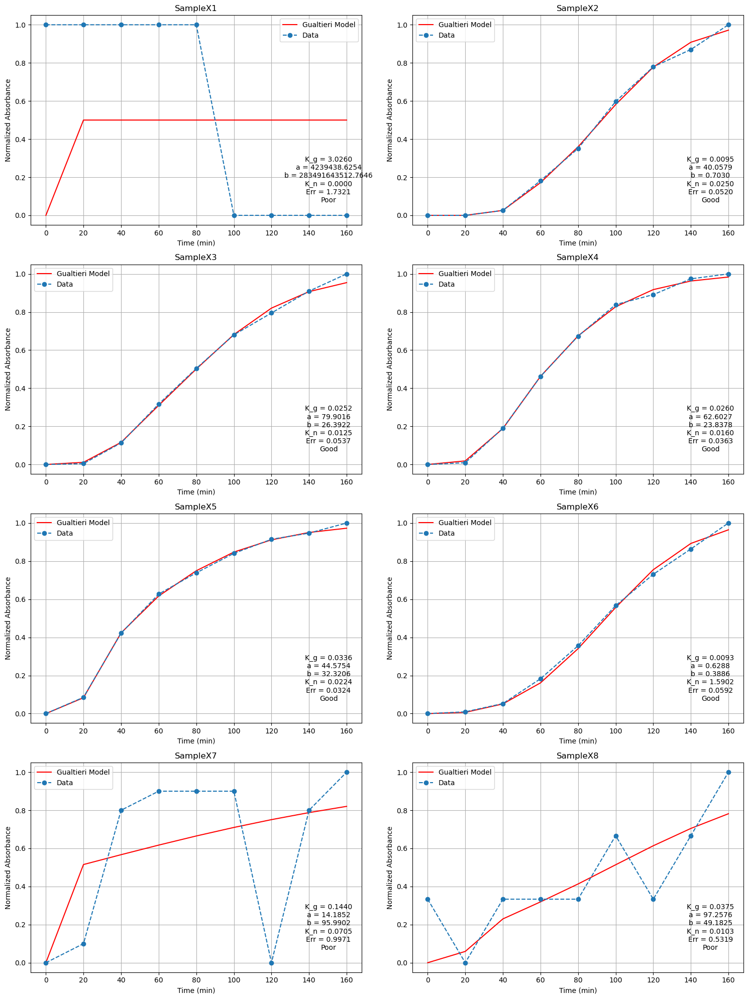

In [37]:
fig, axs = plt.subplots(4, 2, figsize=(15, 20))  # Create a 2x2 grid of subplots
axs = axs.flatten()  # Flatten the 2D array of axes to 1D for easy indexing

for i in range(1, 9):
    I_t = []
    sample_number = i
    for j in range(9):
        row_series = dataframes[j*20].iloc[0]
        matching_columns = row_series[row_series == 400].index[0]
        absorbance_at_400 = dataframes[j*20].loc[sample_number, matching_columns]
        I_t.append(absorbance_at_400)
    
    alpha_data = (np.array(I_t) - min(I_t)) / (max(I_t) - min(I_t))
    t_data = np.array(range(0, 180, 20))

    def gualtieri_model(t, kg, a, b):
        growth = 1 - np.exp(-(kg * t)**3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)

    best_error = np.inf
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b)
                    error = np.linalg.norm(gualtieri_array - alpha_data)

                    if error < best_error and a > 0 and b > 0 and K_g > 0:
                        best_error = error
                        best_params = (K_g, a, b)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[i-1]  # Select the correct subplot
    if best_params is not None:
        K_g, a, b = best_params
        K_n = 1 / a
        error = np.linalg.norm(np.array(best_gualtieri_array) - alpha_data)

    fit_quality = "Good" if error < 0.1 else "Poor"

    ax.plot(t_data, best_gualtieri_array, label='Gualtieri Model', color='red')
    ax.plot(t_data, alpha_data, label='Data', marker='o', linestyle='--')
    ax.text(0.9, 0.1, f'K_g = {K_g:.4f}\na = {a:.4f}\nb = {b:.4f}\nK_n = {K_n:.4f}\nErr = {error:.4f}\n{fit_quality}',
            transform=ax.transAxes, fontsize=10, verticalalignment='bottom', horizontalalignment='center')

    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Normalized Absorbance")
    ax.set_title(f"SampleX{sample_number}")
    ax.grid(True)
    ax.legend()

plt.tight_layout()
plt.show()

<h4>With parameters K_g, a, b and I_max</h4>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\300299197.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\300299197.py:20: RuntimeWarning: overflow encountered in exp
  nucleation = 1 / (1 + np.exp(-(t - a) / b))
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\300299197.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\300299197.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\300299197.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha

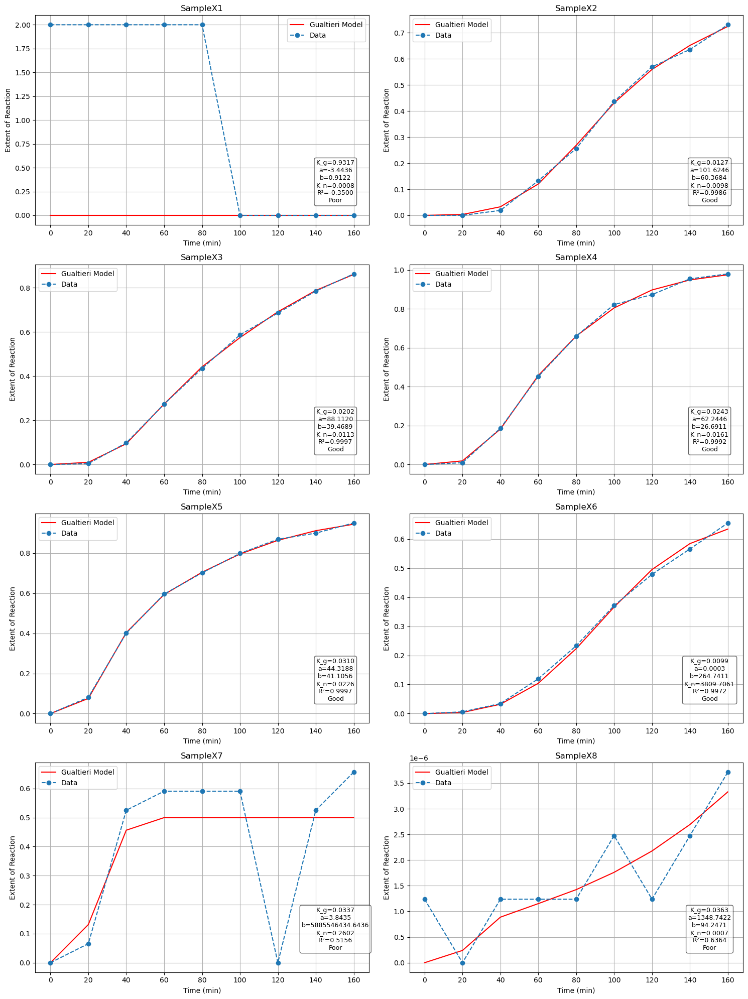

In [ ]:
fig, axs = plt.subplots(4, 2, figsize=(15, 20))  # 2x2 grid of subplots
axs = axs.flatten()  # Flatten to 1D list for easy indexing

for i in range(1, 9): 
    I_t = []
    sample_number = i
    for j in range(9):
        row_series = dataframes[j*20].iloc[0]
        matching_columns = row_series[row_series == 400].index[0]
        absorbance_at_400 = dataframes[j*20].loc[sample_number, matching_columns]
        I_t.append(absorbance_at_400)
    
    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, 180, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t)**3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g = popt[0]
                    a = popt[1]
                    b = popt[2]
                    I_max = popt[3]
                    
                    gualtieri_array = [gualtieri_model(t, K_g, a, b, I_max) for t in t_data]
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[i - 1]  # Select subplot

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)
    else:
        best_gualtieri_array = [0] * len(t_data)
        
    fit_quality = "Good" if r2 > 0.9 else "Poor"

    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red')
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o', linestyle='--')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number}")
    ax.grid(True)
    ax.legend()
    
    # Annotate fit parameters
    ax.text(0.9, 0.1, f'K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}',
            transform=ax.transAxes, fontsize=9,
            ha='center', va='bottom', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.6))

plt.tight_layout()
plt.show()

<h2>Time Dependency of the Parameters and the Fitting</h2>

<h3>Sample 2</h3>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2417268279.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2417268279.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2417268279.py:35: RuntimeWarning: overflow encountered in exp
  growth = 1 - np.exp(-(kg * t) ** 3)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2417268279.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2417268279.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_da

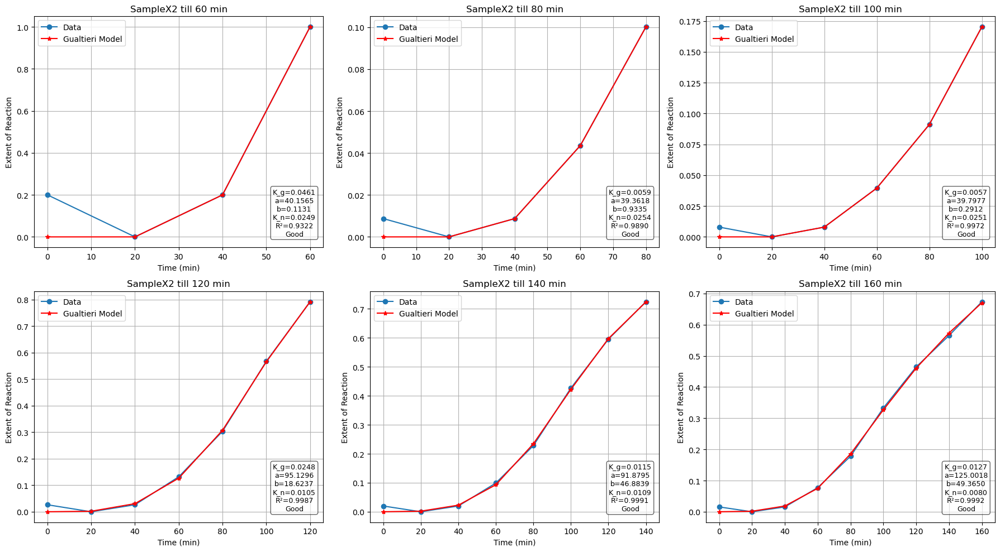

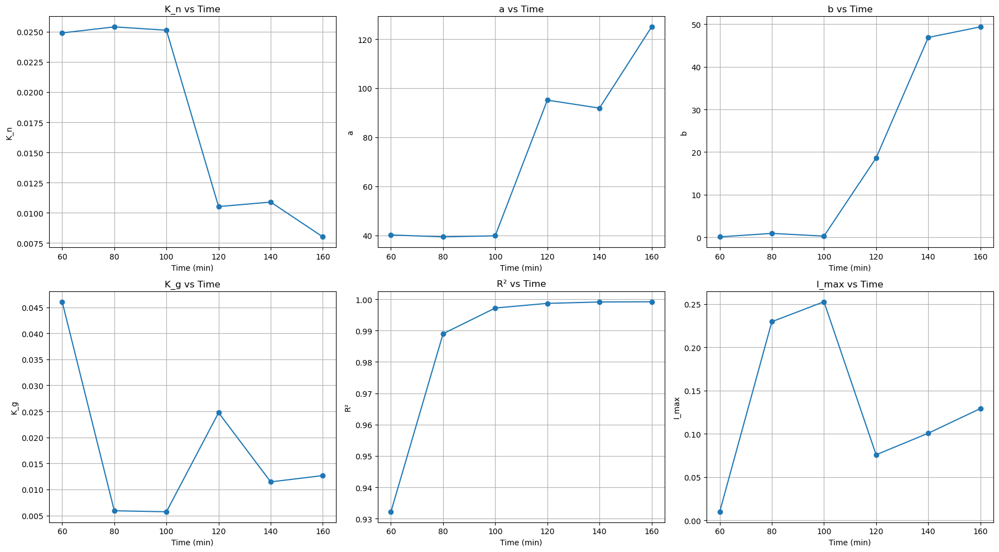

In [31]:
I_t = []
sample_number = 2

# Store fitting results
time_points = []
K_n_list = []
a_list = []
b_list = []
K_g_list = []
r2_list = []
I_max_list = []

# First three measurements (0, 20, 40 min)
for i in [0, 20, 40]:
    row_series = dataframes[i].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[i].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

# Set up subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

# Main fitting loop (j from 3 to 8 => 6 fits)
for plot_index, j in enumerate(range(3, 9)):
    row_series = dataframes[j * 20].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[j * 20].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, j * 20 + 1, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t) ** 3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b, I_max_fit = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b, I_max_fit)
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max_fit >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max_fit)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[plot_index]

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)

        # Store metrics
        time_points.append(j * 20)
        K_n_list.append(K_n)
        a_list.append(a)
        b_list.append(b)
        K_g_list.append(K_g)
        r2_list.append(r2)
        I_max_list.append(I_max)

    else:
        best_gualtieri_array = [0] * len(t_data)
        K_g = a = b = K_n = I_max = r2 = 0

    fit_quality = "Good" if r2 > 0.9 else "Poor"

    # Plot
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o')
    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red', marker='*')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number} till {j*20} min")
    ax.grid(True)
    ax.legend()
    ax.text(0.9, 0.05,
            f"K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}",
            transform=ax.transAxes, fontsize=9, ha='center', bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.6))

plt.tight_layout()

fig2, axs2 = plt.subplots(2, 3, figsize=(18, 10))
axs2 = axs2.flatten()

# Subplot 1: K_n vs Time
axs2[0].plot(time_points, K_n_list, marker='o')
axs2[0].set_title("K_n vs Time")
axs2[0].set_xlabel("Time (min)")
axs2[0].set_ylabel("K_n")
axs2[0].grid(True)

# Subplot 2: a vs Time
axs2[1].plot(time_points, a_list, marker='o')
axs2[1].set_title("a vs Time")
axs2[1].set_xlabel("Time (min)")
axs2[1].set_ylabel("a")
axs2[1].grid(True)

# Subplot 3: b vs Time
axs2[2].plot(time_points, b_list, marker='o')
axs2[2].set_title("b vs Time")
axs2[2].set_xlabel("Time (min)")
axs2[2].set_ylabel("b")
axs2[2].grid(True)

# Subplot 4: K_g vs Time
axs2[3].plot(time_points, K_g_list, marker='o')
axs2[3].set_title("K_g vs Time")
axs2[3].set_xlabel("Time (min)")
axs2[3].set_ylabel("K_g")
axs2[3].grid(True)

# Subplot 5: R² vs Time
axs2[4].plot(time_points, r2_list, marker='o')
axs2[4].set_title("R² vs Time")
axs2[4].set_xlabel("Time (min)")
axs2[4].set_ylabel("R²")
axs2[4].grid(True)

# Subplot 6: I_max vs Time
axs2[5].plot(time_points, I_max_list, marker='o')
axs2[5].set_title("I_max vs Time")
axs2[5].set_xlabel("Time (min)")
axs2[5].set_ylabel("I_max")
axs2[5].grid(True)

plt.tight_layout()
plt.show()


<h3>Sample 3</h3>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\3965785913.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\3965785913.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\3965785913.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\3965785913.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\3965785913.py:53: OptimizeWarning: Covariance of the parameters could not b

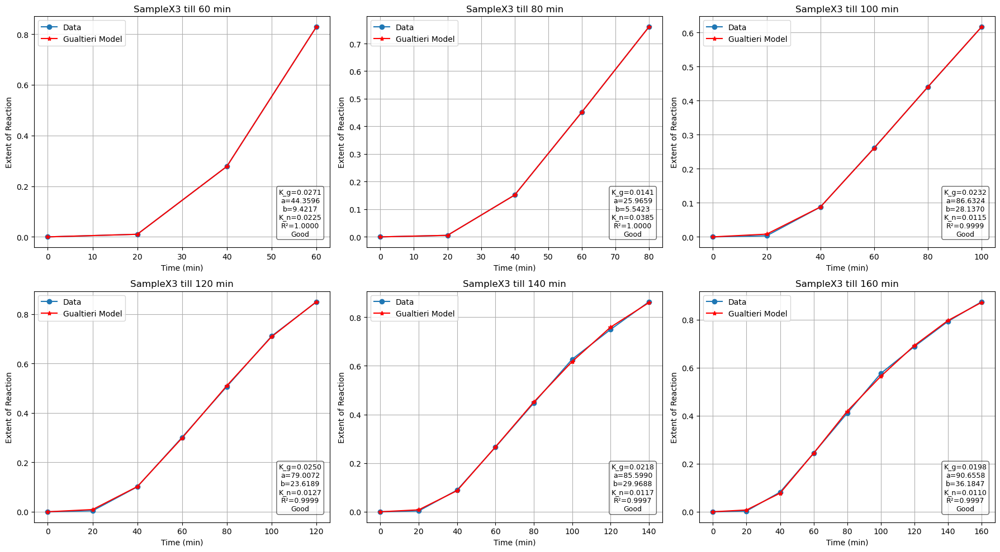

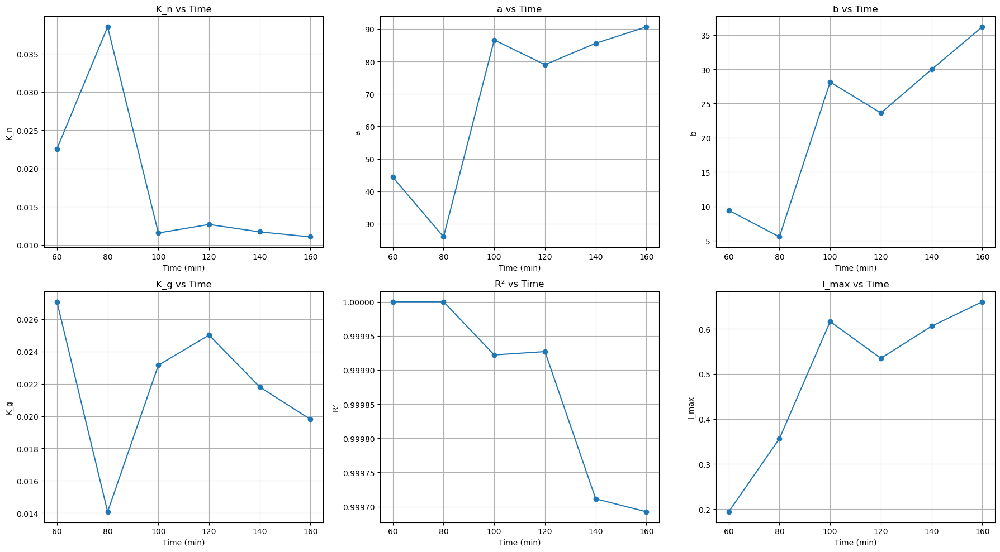

In [32]:
I_t = []
sample_number = 3

# Store fitting results
time_points = []
K_n_list = []
a_list = []
b_list = []
K_g_list = []
r2_list = []
I_max_list = []

# First three measurements (0, 20, 40 min)
for i in [0, 20, 40]:
    row_series = dataframes[i].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[i].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

# Set up subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

# Main fitting loop (j from 3 to 8 => 6 fits)
for plot_index, j in enumerate(range(3, 9)):
    row_series = dataframes[j * 20].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[j * 20].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, j * 20 + 1, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t) ** 3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b, I_max_fit = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b, I_max_fit)
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max_fit >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max_fit)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[plot_index]

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)

        # Store metrics
        time_points.append(j * 20)
        K_n_list.append(K_n)
        a_list.append(a)
        b_list.append(b)
        K_g_list.append(K_g)
        r2_list.append(r2)
        I_max_list.append(I_max)

    else:
        best_gualtieri_array = [0] * len(t_data)
        K_g = a = b = K_n = I_max = r2 = 0

    fit_quality = "Good" if r2 > 0.9 else "Poor"

    # Plot
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o')
    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red', marker='*')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number} till {j*20} min")
    ax.grid(True)
    ax.legend()
    ax.text(0.9, 0.05,
            f"K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}",
            transform=ax.transAxes, fontsize=9, ha='center', bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.6))

plt.tight_layout()

fig2, axs2 = plt.subplots(2, 3, figsize=(18, 10))
axs2 = axs2.flatten()

# Subplot 1: K_n vs Time
axs2[0].plot(time_points, K_n_list, marker='o')
axs2[0].set_title("K_n vs Time")
axs2[0].set_xlabel("Time (min)")
axs2[0].set_ylabel("K_n")
axs2[0].grid(True)

# Subplot 2: a vs Time
axs2[1].plot(time_points, a_list, marker='o')
axs2[1].set_title("a vs Time")
axs2[1].set_xlabel("Time (min)")
axs2[1].set_ylabel("a")
axs2[1].grid(True)

# Subplot 3: b vs Time
axs2[2].plot(time_points, b_list, marker='o')
axs2[2].set_title("b vs Time")
axs2[2].set_xlabel("Time (min)")
axs2[2].set_ylabel("b")
axs2[2].grid(True)

# Subplot 4: K_g vs Time
axs2[3].plot(time_points, K_g_list, marker='o')
axs2[3].set_title("K_g vs Time")
axs2[3].set_xlabel("Time (min)")
axs2[3].set_ylabel("K_g")
axs2[3].grid(True)

# Subplot 5: R² vs Time
axs2[4].plot(time_points, r2_list, marker='o')
axs2[4].set_title("R² vs Time")
axs2[4].set_xlabel("Time (min)")
axs2[4].set_ylabel("R²")
axs2[4].grid(True)

# Subplot 6: I_max vs Time
axs2[5].plot(time_points, I_max_list, marker='o')
axs2[5].set_title("I_max vs Time")
axs2[5].set_xlabel("Time (min)")
axs2[5].set_ylabel("I_max")
axs2[5].grid(True)

plt.tight_layout()
plt.show()


<h3>Sample 4</h3>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2217416066.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2217416066.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2217416066.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2217416066.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2217416066.py:53: OptimizeWarning: Covariance of the parameters could not b

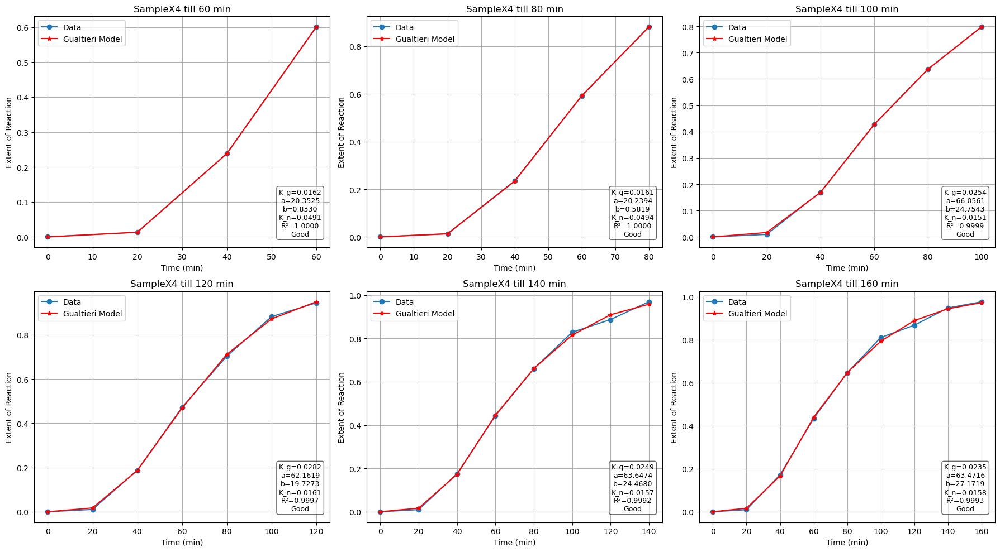

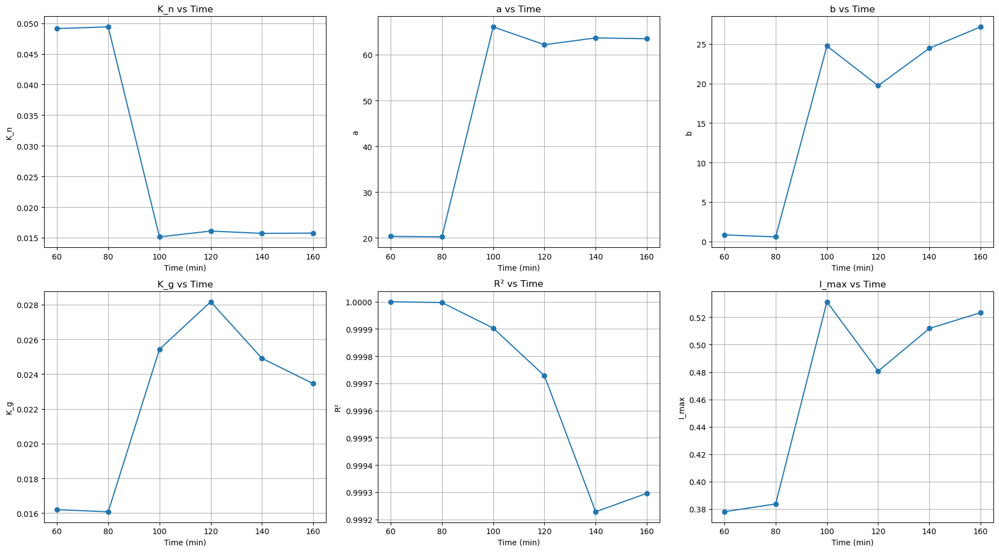

In [33]:
I_t = []
sample_number = 4

# Store fitting results
time_points = []
K_n_list = []
a_list = []
b_list = []
K_g_list = []
r2_list = []
I_max_list = []

# First three measurements (0, 20, 40 min)
for i in [0, 20, 40]:
    row_series = dataframes[i].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[i].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

# Set up subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

# Main fitting loop (j from 3 to 8 => 6 fits)
for plot_index, j in enumerate(range(3, 9)):
    row_series = dataframes[j * 20].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[j * 20].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, j * 20 + 1, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t) ** 3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b, I_max_fit = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b, I_max_fit)
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max_fit >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max_fit)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[plot_index]

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)

        # Store metrics
        time_points.append(j * 20)
        K_n_list.append(K_n)
        a_list.append(a)
        b_list.append(b)
        K_g_list.append(K_g)
        r2_list.append(r2)
        I_max_list.append(I_max)

    else:
        best_gualtieri_array = [0] * len(t_data)
        K_g = a = b = K_n = I_max = r2 = 0

    fit_quality = "Good" if r2 > 0.9 else "Poor"

    # Plot
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o')
    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red', marker='*')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number} till {j*20} min")
    ax.grid(True)
    ax.legend()
    ax.text(0.9, 0.05,
            f"K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}",
            transform=ax.transAxes, fontsize=9, ha='center', bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.6))

plt.tight_layout()

fig2, axs2 = plt.subplots(2, 3, figsize=(18, 10))
axs2 = axs2.flatten()

# Subplot 1: K_n vs Time
axs2[0].plot(time_points, K_n_list, marker='o')
axs2[0].set_title("K_n vs Time")
axs2[0].set_xlabel("Time (min)")
axs2[0].set_ylabel("K_n")
axs2[0].grid(True)

# Subplot 2: a vs Time
axs2[1].plot(time_points, a_list, marker='o')
axs2[1].set_title("a vs Time")
axs2[1].set_xlabel("Time (min)")
axs2[1].set_ylabel("a")
axs2[1].grid(True)

# Subplot 3: b vs Time
axs2[2].plot(time_points, b_list, marker='o')
axs2[2].set_title("b vs Time")
axs2[2].set_xlabel("Time (min)")
axs2[2].set_ylabel("b")
axs2[2].grid(True)

# Subplot 4: K_g vs Time
axs2[3].plot(time_points, K_g_list, marker='o')
axs2[3].set_title("K_g vs Time")
axs2[3].set_xlabel("Time (min)")
axs2[3].set_ylabel("K_g")
axs2[3].grid(True)

# Subplot 5: R² vs Time
axs2[4].plot(time_points, r2_list, marker='o')
axs2[4].set_title("R² vs Time")
axs2[4].set_xlabel("Time (min)")
axs2[4].set_ylabel("R²")
axs2[4].grid(True)

# Subplot 6: I_max vs Time
axs2[5].plot(time_points, I_max_list, marker='o')
axs2[5].set_title("I_max vs Time")
axs2[5].set_xlabel("Time (min)")
axs2[5].set_ylabel("I_max")
axs2[5].grid(True)

plt.tight_layout()
plt.show()


<h3>Sample 5</h3>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\912802443.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\912802443.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\912802443.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\912802443.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\912802443.py:53: OptimizeWarning: Covariance of the parameters could not be est

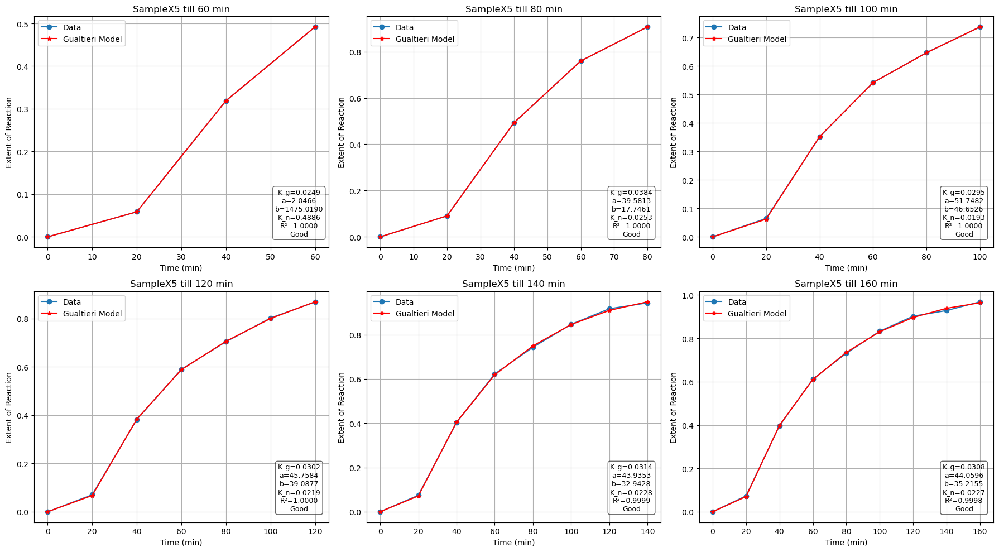

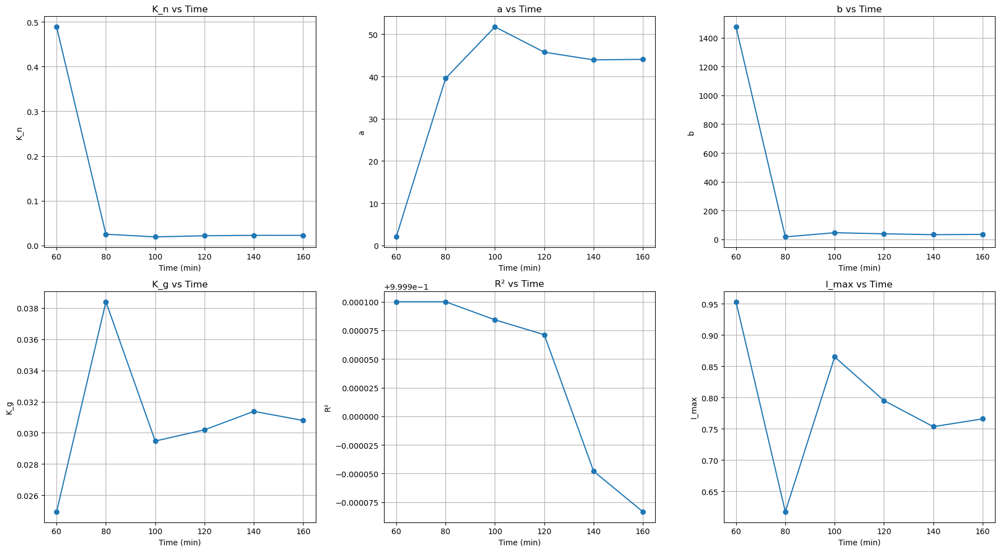

In [34]:
I_t = []
sample_number = 5

# Store fitting results
time_points = []
K_n_list = []
a_list = []
b_list = []
K_g_list = []
r2_list = []
I_max_list = []

# First three measurements (0, 20, 40 min)
for i in [0, 20, 40]:
    row_series = dataframes[i].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[i].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

# Set up subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

# Main fitting loop (j from 3 to 8 => 6 fits)
for plot_index, j in enumerate(range(3, 9)):
    row_series = dataframes[j * 20].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[j * 20].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, j * 20 + 1, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t) ** 3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b, I_max_fit = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b, I_max_fit)
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max_fit >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max_fit)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[plot_index]

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)

        # Store metrics
        time_points.append(j * 20)
        K_n_list.append(K_n)
        a_list.append(a)
        b_list.append(b)
        K_g_list.append(K_g)
        r2_list.append(r2)
        I_max_list.append(I_max)

    else:
        best_gualtieri_array = [0] * len(t_data)
        K_g = a = b = K_n = I_max = r2 = 0

    fit_quality = "Good" if r2 > 0.9 else "Poor"

    # Plot
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o')
    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red', marker='*')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number} till {j*20} min")
    ax.grid(True)
    ax.legend()
    ax.text(0.9, 0.05,
            f"K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}",
            transform=ax.transAxes, fontsize=9, ha='center', bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.6))

plt.tight_layout()

fig2, axs2 = plt.subplots(2, 3, figsize=(18, 10))
axs2 = axs2.flatten()

# Subplot 1: K_n vs Time
axs2[0].plot(time_points, K_n_list, marker='o')
axs2[0].set_title("K_n vs Time")
axs2[0].set_xlabel("Time (min)")
axs2[0].set_ylabel("K_n")
axs2[0].grid(True)

# Subplot 2: a vs Time
axs2[1].plot(time_points, a_list, marker='o')
axs2[1].set_title("a vs Time")
axs2[1].set_xlabel("Time (min)")
axs2[1].set_ylabel("a")
axs2[1].grid(True)

# Subplot 3: b vs Time
axs2[2].plot(time_points, b_list, marker='o')
axs2[2].set_title("b vs Time")
axs2[2].set_xlabel("Time (min)")
axs2[2].set_ylabel("b")
axs2[2].grid(True)

# Subplot 4: K_g vs Time
axs2[3].plot(time_points, K_g_list, marker='o')
axs2[3].set_title("K_g vs Time")
axs2[3].set_xlabel("Time (min)")
axs2[3].set_ylabel("K_g")
axs2[3].grid(True)

# Subplot 5: R² vs Time
axs2[4].plot(time_points, r2_list, marker='o')
axs2[4].set_title("R² vs Time")
axs2[4].set_xlabel("Time (min)")
axs2[4].set_ylabel("R²")
axs2[4].grid(True)

# Subplot 6: I_max vs Time
axs2[5].plot(time_points, I_max_list, marker='o')
axs2[5].set_title("I_max vs Time")
axs2[5].set_xlabel("Time (min)")
axs2[5].set_ylabel("I_max")
axs2[5].grid(True)

plt.tight_layout()
plt.show()


<h3>Sample 6</h3>

C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2517950804.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2517950804.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2517950804.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2517950804.py:53: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
C:\Users\hardi\AppData\Local\Temp\ipykernel_3684\2517950804.py:53: OptimizeWarning: Covariance of the parameters could not b

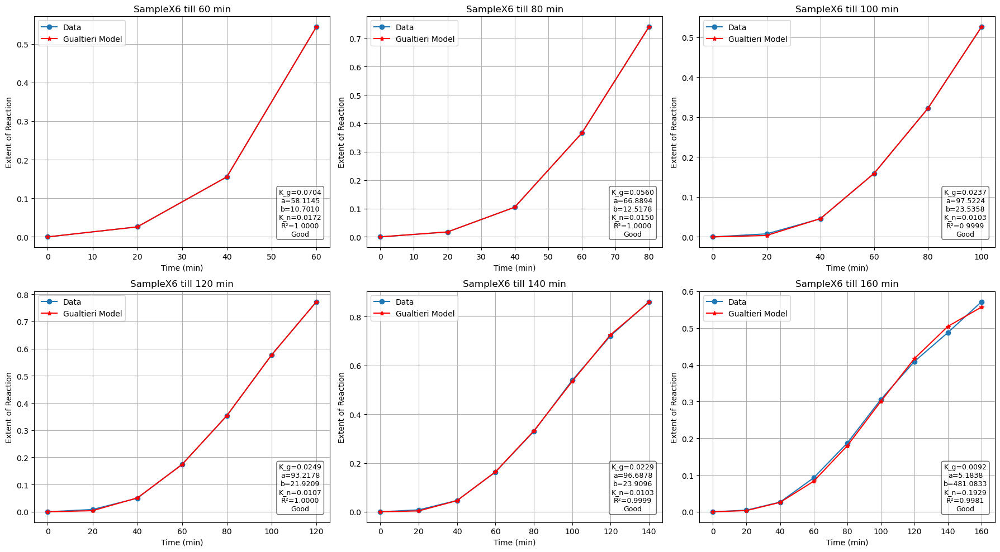

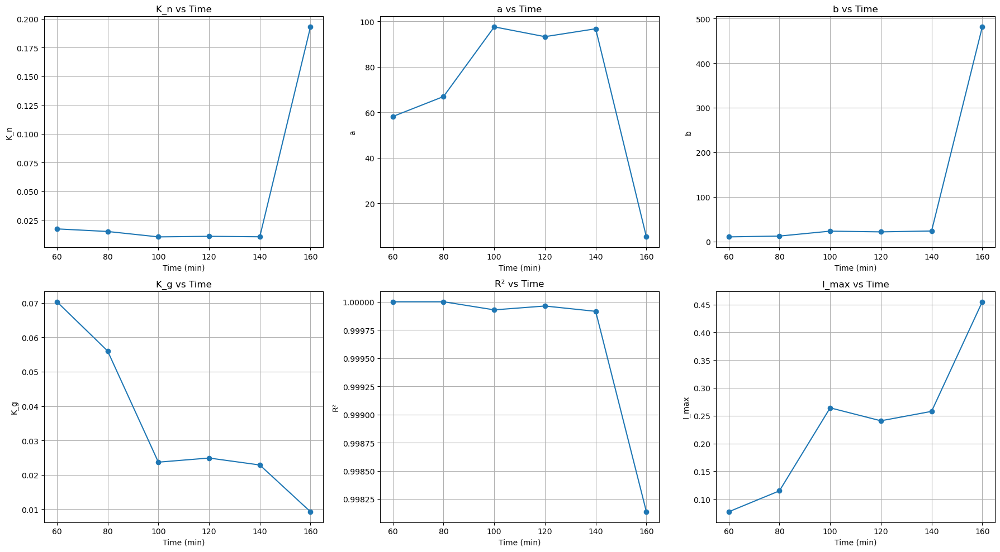

In [35]:
I_t = []
sample_number = 6

# Store fitting results
time_points = []
K_n_list = []
a_list = []
b_list = []
K_g_list = []
r2_list = []
I_max_list = []

# First three measurements (0, 20, 40 min)
for i in [0, 20, 40]:
    row_series = dataframes[i].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[i].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

# Set up subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

# Main fitting loop (j from 3 to 8 => 6 fits)
for plot_index, j in enumerate(range(3, 9)):
    row_series = dataframes[j * 20].iloc[0]
    matching_columns = row_series[row_series == 450].index[0]
    absorbance_at_450 = dataframes[j * 20].loc[sample_number, matching_columns]
    I_t.append(absorbance_at_450)

    alpha_data = np.array(I_t) - min(I_t)
    t_data = np.array(range(0, j * 20 + 1, 20))

    def gualtieri_model(t, kg, a, b, I_max):
        growth = 1 - np.exp(-(kg * t) ** 3)
        nucleation = 1 / (1 + np.exp(-(t - a) / b))
        return growth * nucleation * I_max

    Kg_values = np.linspace(0.01, 0.1, 100)
    a_values = np.linspace(1, 5, 5)
    b_values = np.linspace(1, 5, 5)
    I_max = max(alpha_data)

    best_r2 = 0
    best_params = None
    best_gualtieri_array = None

    for Kg_init in Kg_values:
        for a_init in a_values:
            for b_init in b_values:
                try:
                    p0 = [Kg_init, a_init, b_init, I_max]
                    popt, pcov = curve_fit(gualtieri_model, t_data, alpha_data, p0=p0, maxfev=10000)
                    K_g, a, b, I_max_fit = popt
                    gualtieri_array = gualtieri_model(t_data, K_g, a, b, I_max_fit)
                    r2 = r2_score(alpha_data, gualtieri_array)

                    if r2 > best_r2 and a > 0 and b > 0 and K_g > 0 and I_max_fit >= max(alpha_data):
                        best_r2 = r2
                        best_params = (K_g, a, b, I_max_fit)
                        best_gualtieri_array = gualtieri_array

                except RuntimeError:
                    continue

    ax = axs[plot_index]

    if best_params is not None:
        K_g, a, b, I_max = best_params
        K_n = 1 / a
        r2 = r2_score(alpha_data, best_gualtieri_array)

        # Store metrics
        time_points.append(j * 20)
        K_n_list.append(K_n)
        a_list.append(a)
        b_list.append(b)
        K_g_list.append(K_g)
        r2_list.append(r2)
        I_max_list.append(I_max)

    else:
        best_gualtieri_array = [0] * len(t_data)
        K_g = a = b = K_n = I_max = r2 = 0

    fit_quality = "Good" if r2 > 0.9 else "Poor"

    # Plot
    ax.plot(t_data, alpha_data / I_max, label='Data', marker='o')
    ax.plot(t_data, np.array(best_gualtieri_array) / I_max, label='Gualtieri Model', color='red', marker='*')
    ax.set_xlabel("Time (min)")
    ax.set_ylabel("Extent of Reaction")
    ax.set_title(f"SampleX{sample_number} till {j*20} min")
    ax.grid(True)
    ax.legend()
    ax.text(0.9, 0.05,
            f"K_g={K_g:.4f}\na={a:.4f}\nb={b:.4f}\nK_n={K_n:.4f}\nR²={r2:.4f}\n{fit_quality}",
            transform=ax.transAxes, fontsize=9, ha='center', bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.6))

plt.tight_layout()

fig2, axs2 = plt.subplots(2, 3, figsize=(18, 10))
axs2 = axs2.flatten()

# Subplot 1: K_n vs Time
axs2[0].plot(time_points, K_n_list, marker='o')
axs2[0].set_title("K_n vs Time")
axs2[0].set_xlabel("Time (min)")
axs2[0].set_ylabel("K_n")
axs2[0].grid(True)

# Subplot 2: a vs Time
axs2[1].plot(time_points, a_list, marker='o')
axs2[1].set_title("a vs Time")
axs2[1].set_xlabel("Time (min)")
axs2[1].set_ylabel("a")
axs2[1].grid(True)

# Subplot 3: b vs Time
axs2[2].plot(time_points, b_list, marker='o')
axs2[2].set_title("b vs Time")
axs2[2].set_xlabel("Time (min)")
axs2[2].set_ylabel("b")
axs2[2].grid(True)

# Subplot 4: K_g vs Time
axs2[3].plot(time_points, K_g_list, marker='o')
axs2[3].set_title("K_g vs Time")
axs2[3].set_xlabel("Time (min)")
axs2[3].set_ylabel("K_g")
axs2[3].grid(True)

# Subplot 5: R² vs Time
axs2[4].plot(time_points, r2_list, marker='o')
axs2[4].set_title("R² vs Time")
axs2[4].set_xlabel("Time (min)")
axs2[4].set_ylabel("R²")
axs2[4].grid(True)

# Subplot 6: I_max vs Time
axs2[5].plot(time_points, I_max_list, marker='o')
axs2[5].set_title("I_max vs Time")
axs2[5].set_xlabel("Time (min)")
axs2[5].set_ylabel("I_max")
axs2[5].grid(True)

plt.tight_layout()
plt.show()
